In [324]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.colors import Normalize
import seaborn as sns
from pandas_profiling import ProfileReport

In [323]:
import keras
from keras import metrics
from keras import regularizers
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Activation
from keras.layers import Conv2D, MaxPooling2D
from keras.optimizers import Adam, RMSprop
from keras.callbacks import TensorBoard, EarlyStopping, ModelCheckpoint
from keras.utils import plot_model
from keras.models import load_model
from sklearn.metrics import accuracy_score

<h2> Loading data </h2>

In [123]:
kc_house_data = pd.read_csv("data/kc_house_data.csv")

<h2> Exploring dataset </h2>

In [124]:
kc_house_data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


<h3> Columns description </h3>

In [125]:
kc_house_data.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

id - Unique ID for each home sold

date - Date of the home sale

price - Price of each home sold

bedrooms - Number of bedrooms

bathrooms - Number of bathrooms, where .5 accounts for a room with a toilet but no shower

sqft_living - Square footage of the apartments interior living space

sqft_lot - Square footage of the land space

floors - Number of floors

waterfront - A dummy variable for whether the apartment was overlooking the waterfront or not

view - An index from 0 to 4 of how good the view of the property was

condition - An index from 1 to 5 on the condition of the apartment,

grade - An index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.

sqft_above - The square footage of the interior housing space that is above ground level

sqft_basement - The square footage of the interior housing space that is below ground level

yr_built - The year the house was initially built

yr_renovated - The year of the house’s last renovation

zipcode - What zipcode area the house is in

lat - Lattitude

long - Longitude

sqft_living15 - The square footage of interior housing living space for the nearest 15 neighbors

sqft_lot15 - The square footage of the land lots of the nearest 15 neighbors

<h3> Checking for nulls </h3>

In [126]:
kc_house_data.isna().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [127]:
print(kc_house_data.dtypes)

id                 int64
date              object
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object


<h3> Detailed overview of dataset with pandas_profiling</h3>

In [128]:
profile = ProfileReport(kc_house_data, title='Dataset Report', explorative=True)

In [129]:
profile

<h3> Looking at correlations </h3>

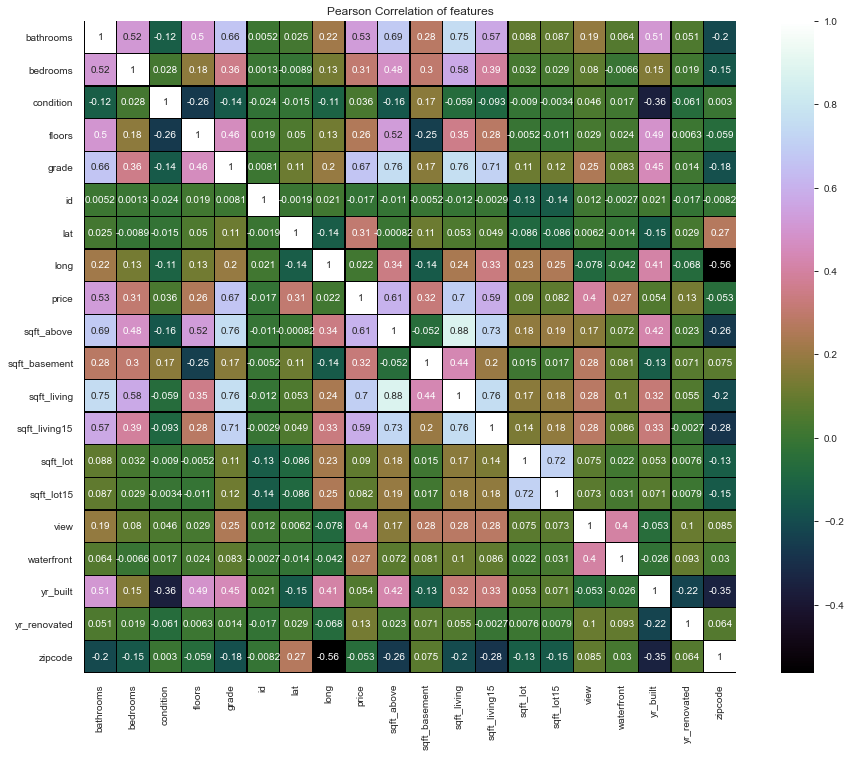

In [130]:
str_list = [] # empty list to contain columns with strings (words)
for colname, colvalue in kc_house_data.iteritems():
    if type(colvalue[1]) == str:
         str_list.append(colname)
# Get to the numeric columns by inversion            
num_list = kc_house_data.columns.difference(str_list) 
# Create Dataframe containing only numerical features
house_num = kc_house_data[num_list]
f, ax = plt.subplots(figsize=(16, 12))
plt.title('Pearson Correlation of features')
# Draw the heatmap using seaborn
sns.heatmap(house_num.astype(float).corr(),linewidths=0.25,vmax=1.0, square=True, cmap="cubehelix", linecolor='k', annot=True)

In [131]:
abs(kc_house_data.corr() > 0.66)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
price,False,True,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False
bedrooms,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
bathrooms,False,False,False,True,True,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False
sqft_living,False,True,False,True,True,False,False,False,False,False,True,True,False,False,False,False,False,False,True,False
sqft_lot,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True
floors,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False
waterfront,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False
view,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
condition,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False


In [132]:
kc_house_data.corr()['price'].sort_values(ascending=False)

price            1.000000
sqft_living      0.702035
grade            0.667434
sqft_above       0.605567
sqft_living15    0.585379
bathrooms        0.525138
view             0.397293
sqft_basement    0.323816
bedrooms         0.308350
lat              0.307003
waterfront       0.266369
floors           0.256794
yr_renovated     0.126434
sqft_lot         0.089661
sqft_lot15       0.082447
yr_built         0.054012
condition        0.036362
long             0.021626
id              -0.016762
zipcode         -0.053203
Name: price, dtype: float64

<h3>Dropping some columns</h3>

In [133]:
kc_house_data = kc_house_data.drop(['id', 'date'],axis=1)

In [134]:
kc_house_data.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15'],
      dtype='object')

<h3> Looking for outliers </h3>

In [135]:
kc_house_data.describe()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


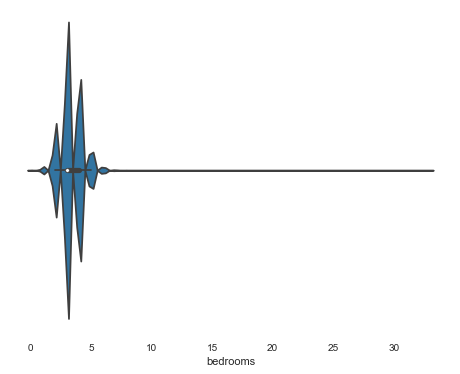

In [136]:
plt.figure(figsize=(8,6))
sns.violinplot(kc_house_data.bedrooms)

In [137]:
kc_house_data.bedrooms.sort_values(ascending = False).head()

15870    33
8757     11
19254    10
13314    10
15161    10
Name: bedrooms, dtype: int64

In [138]:
print(kc_house_data.loc[15856])
print(kc_house_data.loc[8748])

price            539000.0000
bedrooms              3.0000
bathrooms             1.7500
sqft_living        1790.0000
sqft_lot           9860.0000
floors                1.0000
waterfront            0.0000
view                  0.0000
condition             4.0000
grade                 7.0000
sqft_above         1410.0000
sqft_basement       380.0000
yr_built           1978.0000
yr_renovated          0.0000
zipcode           98052.0000
lat                  47.6989
long               -122.1200
sqft_living15      1820.0000
sqft_lot15         9555.0000
Name: 15856, dtype: float64
price            275000.0000
bedrooms              3.0000
bathrooms             1.0000
sqft_living        1080.0000
sqft_lot           6000.0000
floors                1.0000
waterfront            0.0000
view                  0.0000
condition             4.0000
grade                 7.0000
sqft_above         1080.0000
sqft_basement         0.0000
yr_built           1952.0000
yr_renovated          0.0000
zipcode        

<h3> Dropping rows with more than 10 bedrooms as they seems incorrect </h3>

In [139]:
kc_house_data = kc_house_data[kc_house_data.bedrooms <= 10]

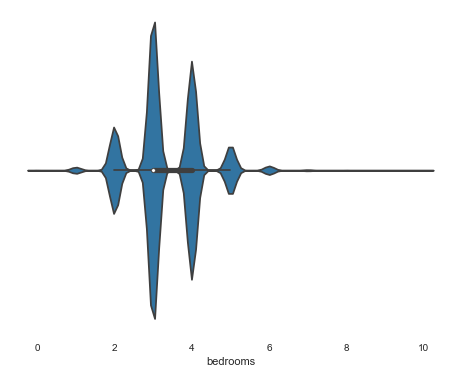

In [140]:
plt.figure(figsize=(8,6))
sns.violinplot(kc_house_data.bedrooms)

<h3> Looking into relationships of price and other variables </h3>

In [141]:
df_zipcode = kc_house_data.groupby('zipcode').aggregate(np.mean)

In [142]:
df_zipcode.reset_index(inplace=True)
df_zipcode.head()

,zipcode,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15
0,98001,2.808047e+05,3.383978,2.006215,1900.856354,14937.450276,1.429558,0.000000,0.102210,3.337017,7.295580,1721.325967,179.530387,1980.679558,43.801105,47.309020,-122.270646,1828.856354,11214.403315
1,98002,2.342840e+05,3.326633,1.839196,1627.743719,7517.633166,1.334171,0.000000,0.010050,3.743719,6.693467,1522.537688,105.206030,1967.773869,59.889447,47.308780,-122.213357,1479.030151,7585.482412
2,98003,2.941113e+05,3.357143,2.047321,1928.882143,10603.096429,1.310714,0.000000,0.214286,3.371429,7.542857,1663.550000,265.332143,1976.885714,21.360714,47.315741,-122.310054,1876.196429,9746.178571
3,98004,1.355927e+06,3.854890,2.527603,2909.022082,13104.220820,1.432177,0.003155,0.305994,3.495268,8.687697,2419.842271,489.179811,1971.470032,208.145110,47.616183,-122.205189,2674.700315,12805.022082
4,98005,8.101649e+05,3.851190,2.424107,2656.803571,19928.785714,1.279762,0.000000,0.095238,3.696429,8.488095,2160.196429,496.607143,1969.744048,47.630952,47.611532,-122.167268,2567.863095,18367.773810


<h3> Price distribution </h3>

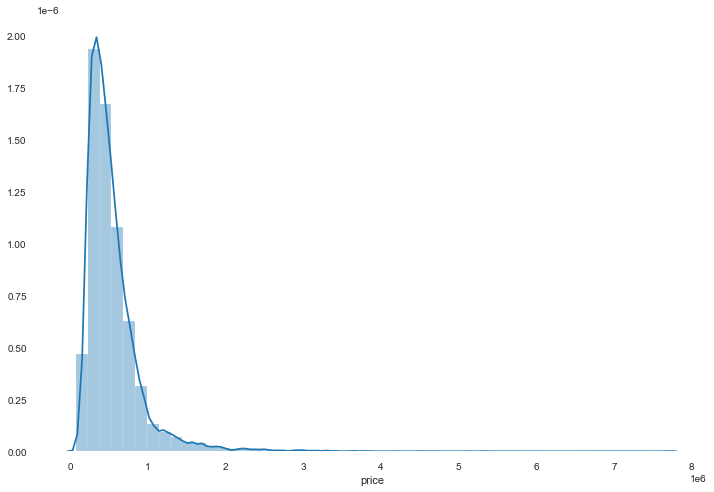

In [143]:
plt.figure(figsize=(12,8))
sns.distplot(kc_house_data['price'])

<h3>Bedrooms</h3>

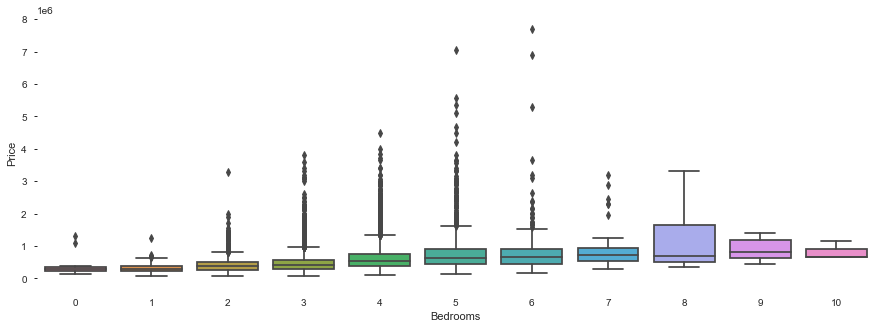

In [144]:
f, axes = plt.subplots(1, 1,figsize=(15,5))
sns.boxplot(x=kc_house_data['bedrooms'],y=kc_house_data['price'])
sns.despine(left=True, bottom=True)
axes.set(xlabel='Bedrooms', ylabel='Price')
axes.yaxis.tick_left()

<h3>Floors</h3>

[Text(0, 0.5, 'Price'), Text(0.5, 0, 'Floors')]

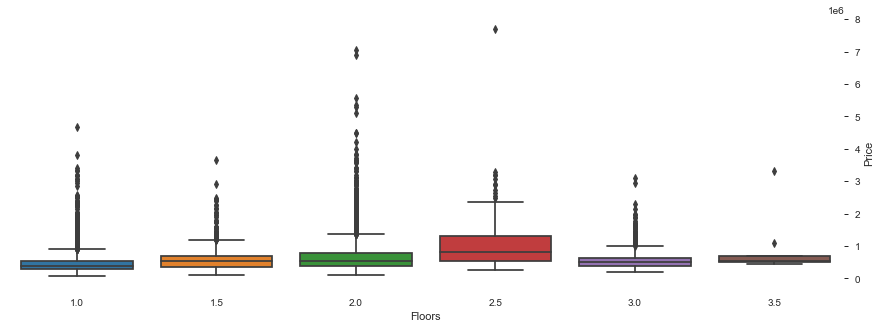

In [145]:
f, axes = plt.subplots(1, 1,figsize=(15,5))
sns.boxplot(x=kc_house_data['floors'],y=kc_house_data['price'])
sns.despine(left=True, bottom=True)

axes.yaxis.set_label_position("right")
axes.yaxis.tick_right()
axes.set(xlabel='Floors', ylabel='Price')

<h3>Waterfornt and view</h3>

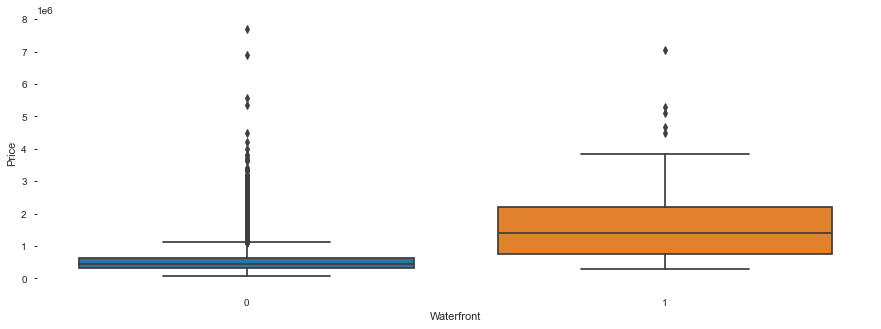

In [146]:
f, axes = plt.subplots(1, 1,figsize=(15,5))
sns.boxplot(x=kc_house_data['waterfront'], y=kc_house_data['price'])
sns.despine(left=True, bottom=True)
axes.set(xlabel='Waterfront', ylabel='Price')
axes.yaxis.tick_left()

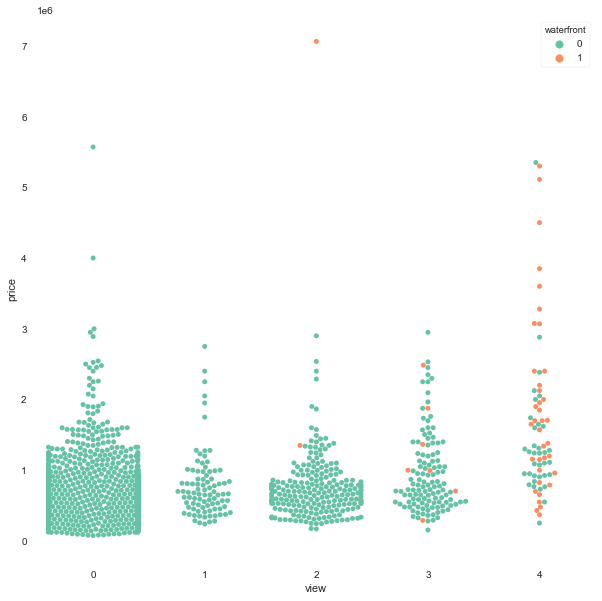

In [147]:
plt.figure(figsize=(10,10))
ax = sns.swarmplot(x="view", y="price", hue="waterfront",data = kc_house_data[:5000], palette="Set2")

<h3> Grade </h3>

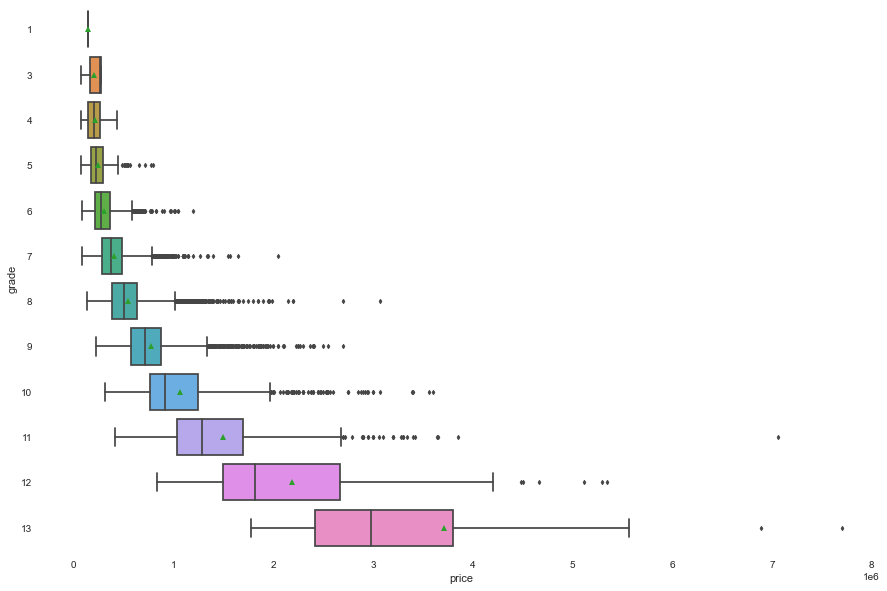

In [148]:
fig, axarr = plt.subplots(1, figsize=(15,10))
sns.boxplot(y = 'grade', x = 'price', data = kc_house_data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3)
plt.show()

<h3> sqft_living </h3>

E:\Anaconda\lib\site-packages\seaborn\axisgrid.py:2272: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


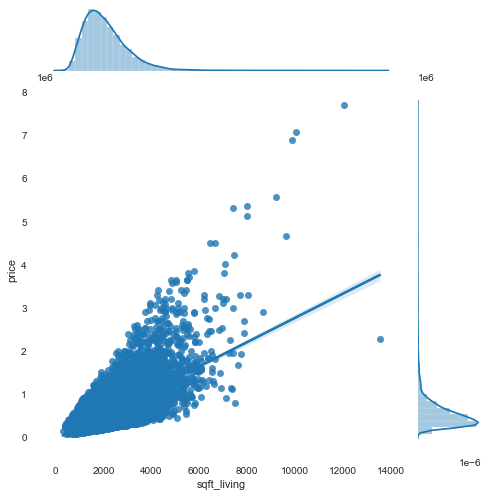

In [149]:
sns.jointplot(x="sqft_living", y="price", data=kc_house_data, kind = 'reg', size = 7)
plt.show()

<h3> sqft_lot </h3>

E:\Anaconda\lib\site-packages\seaborn\axisgrid.py:2272: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


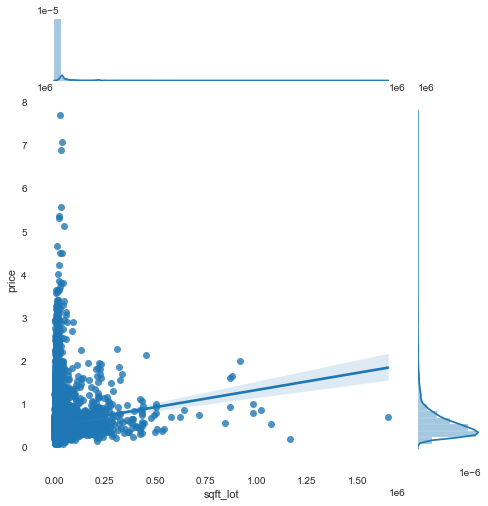

In [150]:
sns.jointplot(x="sqft_lot", y="price", data=kc_house_data, kind = 'reg', size = 7)
plt.show()

E:\Anaconda\lib\site-packages\seaborn\axisgrid.py:2272: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


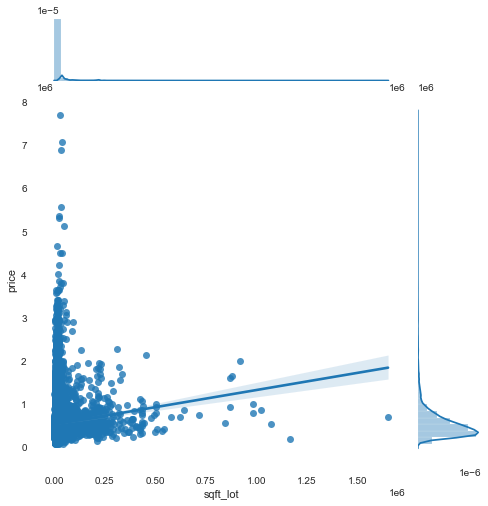

In [151]:
sns.jointplot(x="sqft_lot", y="price", data=kc_house_data, kind = 'reg', size = 7)
plt.show()

<h3> sqft_above </h3>

E:\Anaconda\lib\site-packages\seaborn\axisgrid.py:2272: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


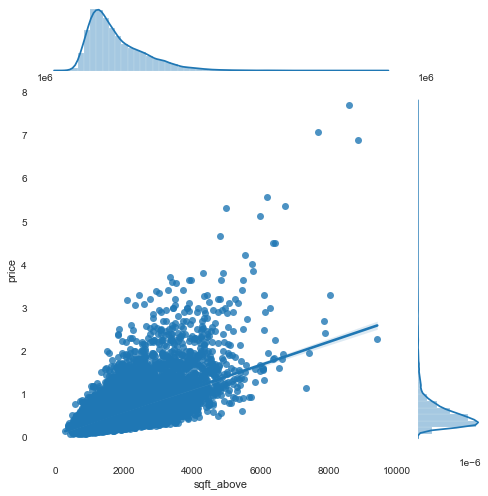

In [152]:
sns.jointplot(x="sqft_above", y="price", data=kc_house_data, kind = 'reg', size = 7)
plt.show()

<h3> sqft_basement</h3>

E:\Anaconda\lib\site-packages\seaborn\axisgrid.py:2272: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


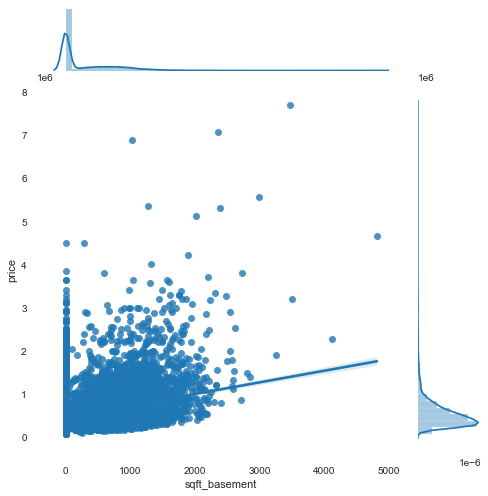

In [153]:
sns.jointplot(x="sqft_basement", y="price", data=kc_house_data, kind = 'reg', size = 7)
plt.show()

<h3> relationship beetween different sqft parameters and price </h3>

E:\Anaconda\lib\site-packages\seaborn\axisgrid.py:2079: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


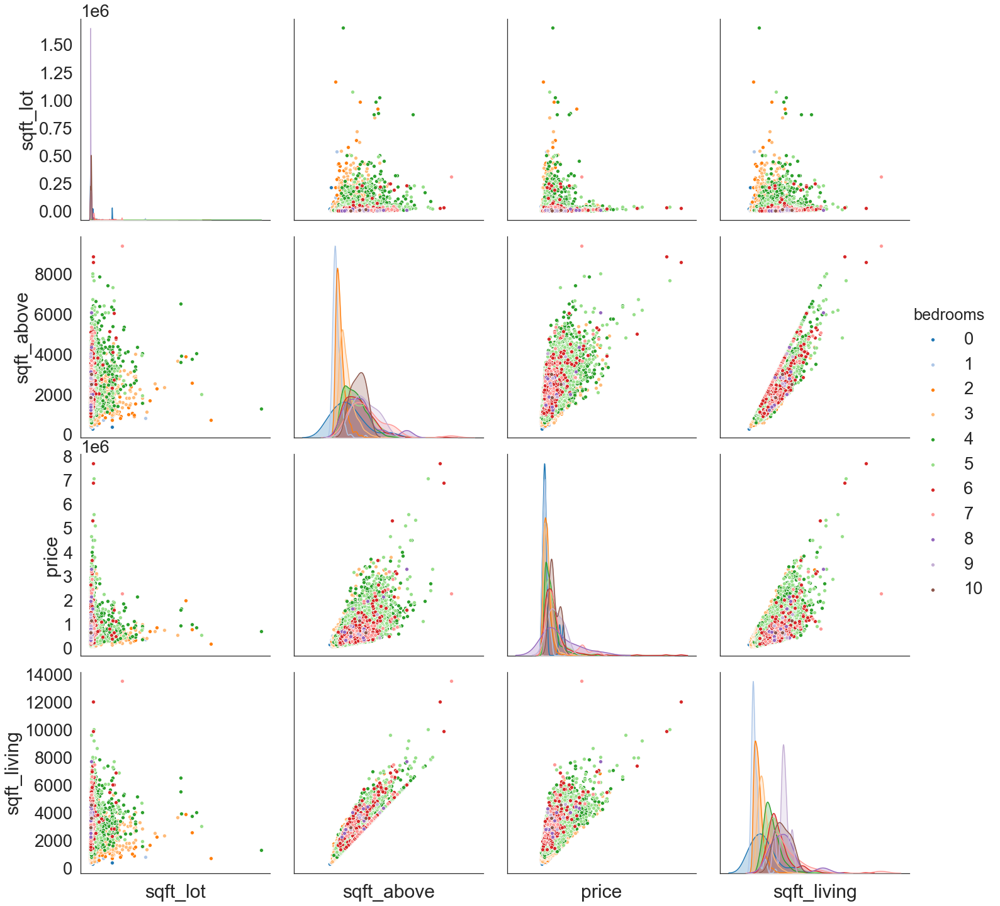

In [154]:
with sns.plotting_context("notebook",font_scale=2.5):
    g = sns.pairplot(kc_house_data[['sqft_lot','sqft_above','price','sqft_living','bedrooms']], 
                 hue='bedrooms', palette='tab20',size=5)
g.set(xticklabels=[]);

<h3> geographical features </h3>

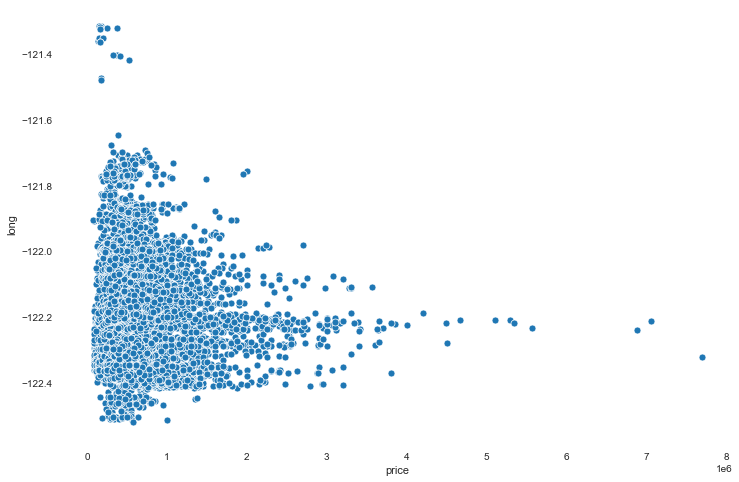

In [155]:
plt.figure(figsize=(12,8))
sns.scatterplot(x='price',y='long',data=kc_house_data)

<h3> Looking into location price relationship on map </h3>

Text(0.5, 1.0, 'Price')

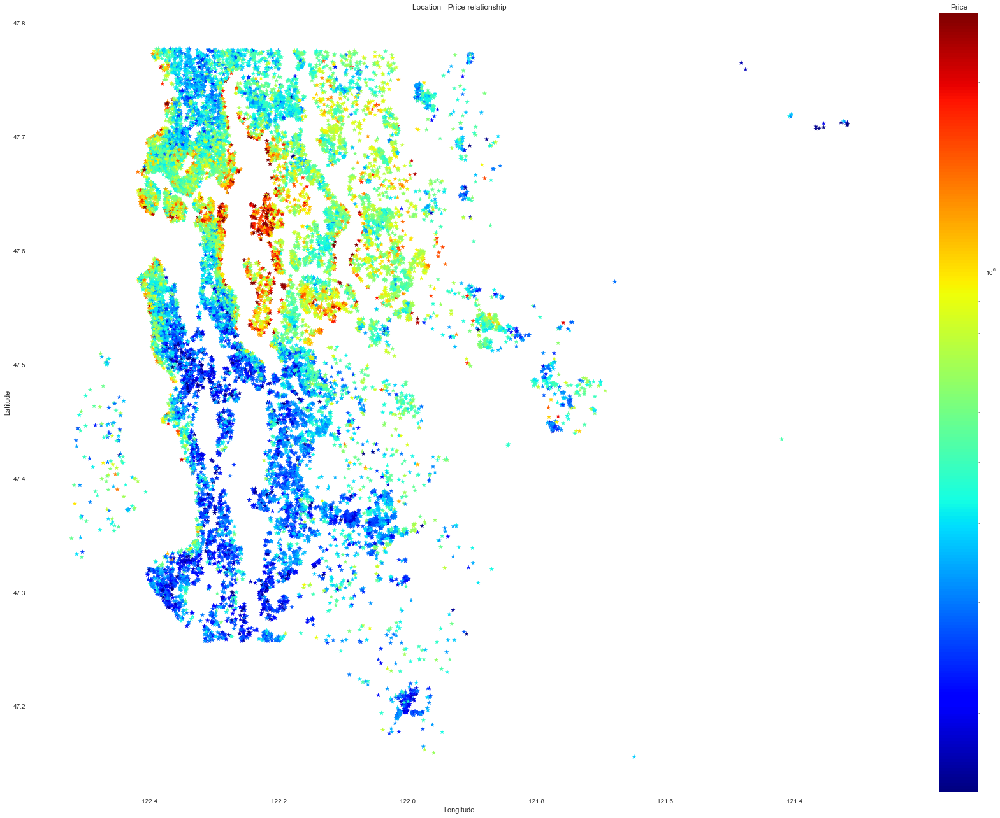

In [156]:
plt.figure(figsize=(30,22.5))
vmin = np.min(kc_house_data.price)
vmax = np.max(kc_house_data.price)
norm = colors.LogNorm(vmin*2,vmax/3)
plt.scatter(kc_house_data.long,kc_house_data.lat, marker='*',c=kc_house_data.price,norm=norm,cmap='jet') 
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Location - Price relationship')
clb = plt.colorbar() 
clb.ax.set_title('Price')

<img src="data/king_county_satellite.jpg">

<h1> Modelling </h1>

In [157]:
kc_house_data.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


<h3> Splitting into train and test and scaling  </h3>

In [348]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

X = kc_house_data.drop('price', axis = 1)
Y = kc_house_data['price']

scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

X_train, X_test, Y_train, Y_test = train_test_split(X,Y,test_size=0.3,random_state=101)

print(X_train.shape)
print(X_test.shape)

(15127, 18)
(6484, 18)


In [159]:
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn import model_selection
import scipy.stats as stats
import sklearn.linear_model as lm
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler

from sklearn.model_selection import KFold
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

<h2> Linear regression </h2>

In [160]:
kfold = KFold(n_splits=5, random_state=123)

E:\Anaconda\lib\site-packages\sklearn\model_selection\_split.py:296: FutureWarning: Setting a random_state has no effect since shuffle is False. This will raise an error in 0.24. You should leave random_state to its default (None), or set shuffle=True.
  FutureWarning


In [161]:
param_grid = {
            'fit_intercept':[True,False],
            'normalize': [True,False],
            }

reg =LinearRegression()
grid_LR = GridSearchCV(LinearRegression(), param_grid, scoring='r2', cv=kfold, return_train_score=True)

grid_LR.fit(X_train, Y_train)
grid_LR.best_params_

{'fit_intercept': True, 'normalize': False}

In [206]:
Y_train_reg_LR = grid_LR.predict(X_train)
Y_test_reg_LR = grid_LR.predict(X_test)

In [207]:
from sklearn.metrics import r2_score

y_train_reg_LR_res = r2_score(Y_train, Y_train_reg_LR)
y_test_reg_LR_res = r2_score(Y_test, Y_test_reg_LR)

print('train result:', y_train_reg_LR_res)
print('test result:', y_test_reg_LR_res)

train result: 0.6992053554744505
test result: 0.7022968766528054


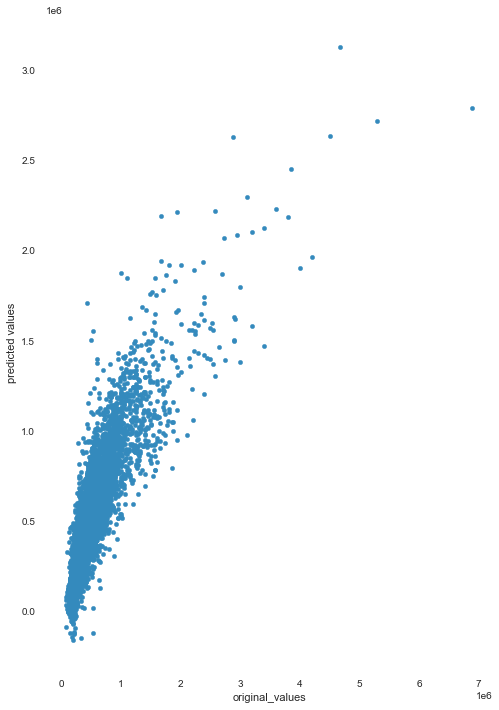

In [306]:
LR_pred = pd.DataFrame({"original_values": Y_test, "predicted values": Y_test_reg_LR})
LR_pred.plot(x = "original_values", y = "predicted values", kind = "scatter")

<h3> Elastic-Net </h3>

In [166]:
from sklearn.linear_model import ElasticNet

param_grid = {'fit_intercept':[True,False], 
              'l1_ratio': [0, 0.2, 0.4, 0.6, 0.8, 1],
              'selection': ['cyclic', 'random'],
              'alpha' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
              'tol': [10]
                 }

grid_elastic = GridSearchCV(ElasticNet(), param_grid, return_train_score = True, scoring='r2')

grid_elastic.fit(X, Y)
grid_elastic.best_params_

{'alpha': 0.01,
 'fit_intercept': True,
 'l1_ratio': 0,
 'selection': 'cyclic',
 'tol': 10}

In [167]:
Y_train_reg_elastic = grid_elastic.predict(X_train)
Y_test_reg_elastic = grid_elastic.predict(X_test)

In [205]:
y_train_reg_elastic_res = r2_score(Y_train, Y_train_reg_elastic)
y_test_reg_elastic_res = r2_score(Y_test, Y_test_reg_elastic)

print('train result:', y_train_reg_elastic_res)
print('test result:', y_test_reg_elastic_res)

train result: 0.6179390815956096
test result: 0.6290517563797215


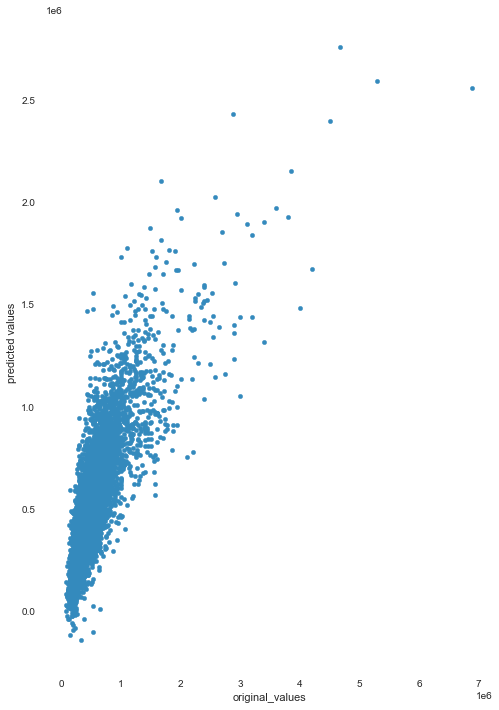

In [307]:
LR_pred = pd.DataFrame({"original_values": Y_test, "predicted values": Y_test_reg_elastic})
LR_pred.plot(x = "original_values", y = "predicted values", kind = "scatter")

<h3> Lasso </h3>

In [169]:
from sklearn.linear_model import ElasticNet

param_grid = {'fit_intercept':[True,False], 
              'l1_ratio': [0, 0.2, 0.4, 0.6, 0.8, 1],
              'selection': ['cyclic', 'random'],
              'alpha' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
              'tol': [0.5]
                 }

grid_elastic = GridSearchCV(ElasticNet(), param_grid, return_train_score = True, scoring='r2')

grid_elastic.fit(X, Y)
grid_elastic.best_params_

{'alpha': 0.01,
 'fit_intercept': True,
 'l1_ratio': 0.8,
 'selection': 'cyclic',
 'tol': 0.5}

In [170]:
Y_train_reg_lasso = grid_elastic.predict(X_train)
Y_test_reg_lasso = grid_elastic.predict(X_test)

In [204]:
y_train_reg_lasso_res = r2_score(Y_train, Y_train_reg_lasso)
y_test_reg_lasso_res = r2_score(Y_test, Y_test_reg_lasso)

print('train result:', y_train_reg_lasso_res)
print('test result:', y_test_reg_lasso_res)

train result: 0.6871839122185219
test result: 0.6922727560695733


<h3> Bayesian Ridge </h3>

In [172]:
from sklearn.linear_model import BayesianRidge

param_grid = {'alpha_1' : [0.0001, 0.01, 1, 100],
              'alpha_2' : [0.0001, 0.01, 1, 100],
              'lambda_1' : [0.0001, 0.01, 1, 100],
              'lambda_2' : [0.0001, 0.01, 1, 100]
             }

grid_elastic = GridSearchCV(BayesianRidge(), param_grid, return_train_score = True, scoring='r2')

grid_elastic.fit(X, Y)
grid_elastic.best_params_

{'alpha_1': 0.0001, 'alpha_2': 1, 'lambda_1': 0.01, 'lambda_2': 1}

In [173]:
Y_train_reg_bayesian = grid_elastic.predict(X_train)
Y_test_reg_bayesian = grid_elastic.predict(X_test)

In [201]:
y_train_reg_bayesian_res = r2_score(Y_train, Y_train_reg_bayesian)
y_test_reg_bayesian_res = r2_score(Y_test, Y_test_reg_bayesian)

print('train result:', y_train_reg_bayesian_res)
print('test result:', y_test_reg_bayesian_res)

train result: 0.6990752611476774
test result: 0.7029921025928172


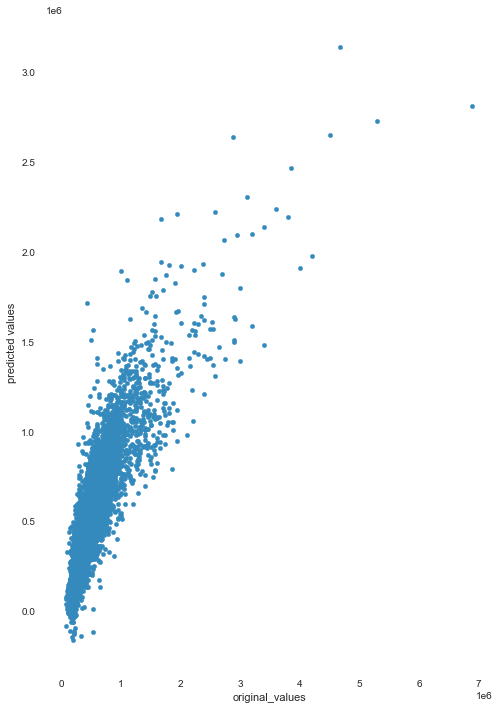

In [309]:
LR_pred = pd.DataFrame({"original_values": Y_test, "predicted values": Y_test_reg_bayesian})
LR_pred.plot(x = "original_values", y = "predicted values", kind = "scatter")

<h3> SGDRegressor </h3>

In [175]:
from sklearn.linear_model import SGDRegressor

param_grid = {'loss' : ['squared_loss', 'huber'],
              'alpha' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
              'l1_ratio': [0, 0.2, 0.4, 0.6, 0.8, 1],
              'tol': [0.5]
             }

grid_elastic = GridSearchCV(SGDRegressor(), param_grid, return_train_score = True, scoring='r2')

grid_elastic.fit(X, Y)
grid_elastic.best_params_

{'alpha': 0.0001, 'l1_ratio': 0, 'loss': 'squared_loss', 'tol': 0.5}

In [176]:
Y_train_reg_sgdr = grid_elastic.predict(X_train)
Y_test_reg_sgdr = grid_elastic.predict(X_test)

In [200]:
y_train_reg_sgdr_res = r2_score(Y_train, Y_train_reg_sgdr)
y_test_reg_sgdr_res = r2_score(Y_test, Y_test_reg_sgdr)

print('train result:', y_train_reg_sgdr_res)
print('test result:', y_test_reg_sgdr_res)

train result: 0.6977053585443178
test result: 0.7022734697174224


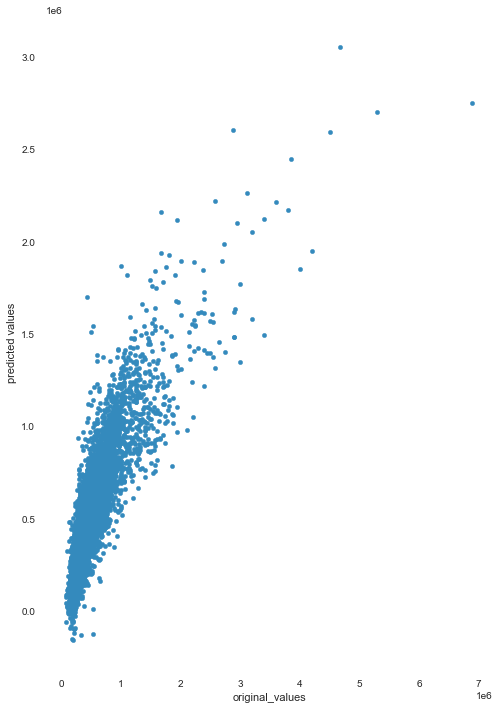

In [310]:
LR_pred = pd.DataFrame({"original_values": Y_test, "predicted values": Y_test_reg_sgdr})
LR_pred.plot(x = "original_values", y = "predicted values", kind = "scatter")

In [ ]:
LR_pred = pd.DataFrame({"original_values": Y_test, "predicted values": Y_test_reg_sgdr})
LR_pred.plot(x = "original_values", y = "predicted values", kind = "scatter")

<h3> AdaBoostRegressor </h3>

In [313]:
from sklearn.ensemble import AdaBoostRegressor

param_grid = {'n_estimators' :[5,10,20,50,100,300]}

grid_elastic = GridSearchCV(AdaBoostRegressor(), param_grid, return_train_score = True, scoring='r2')

grid_elastic.fit(X, Y)
grid_elastic.best_params_

{'n_estimators': 5}

In [314]:
Y_train_reg_ada = grid_elastic.predict(X_train)
Y_test_reg_ada = grid_elastic.predict(X_test)

In [315]:
y_train_reg_ada_res = r2_score(Y_train, Y_train_reg_ada)
y_test_reg_ada_res = r2_score(Y_test, Y_test_reg_ada)

print('train result:', y_train_reg_ada_res)
print('test result:', y_test_reg_ada_res)

train result: 0.6713070343776597
test result: 0.6836745686916506


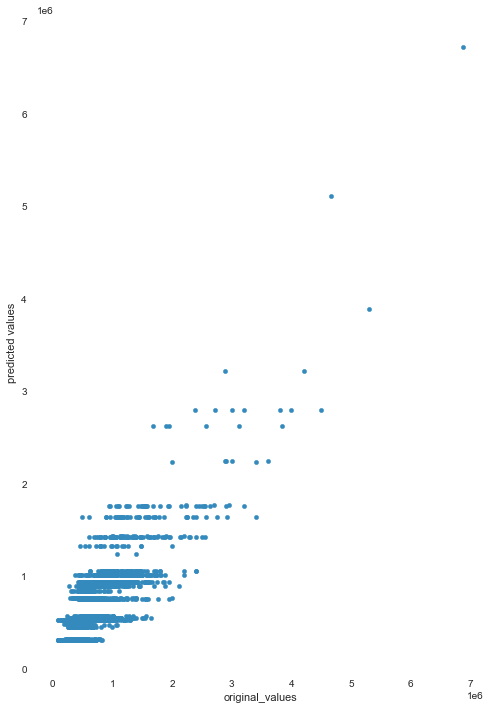

In [316]:
LR_pred = pd.DataFrame({"original_values": Y_test, "predicted values": Y_test_reg_ada})
LR_pred.plot(x = "original_values", y = "predicted values", kind = "scatter")

<h2> Comparing R Squared of different methods </h2>

In [216]:
results =  pd.DataFrame({
    'Method':['Linear Regression', 'Elastic-Net', 'Lasso', 'Bayessian Ridge', 'SGDRegressor', 'AdaBoostRegressor'],
    'Train Results' : [y_train_reg_LR_res, y_train_reg_elastic_res, y_train_reg_lasso_res, y_train_reg_bayesian_res, y_train_reg_sgdr_res, y_train_reg_ada_res],
    'Test Results' : [y_test_reg_LR_res, y_test_reg_elastic_res, y_test_reg_lasso_res, y_test_reg_bayesian_res, y_test_reg_sgdr_res, y_test_reg_ada_res]
})

In [217]:
results

,Method,Train Results,Test Results
0,Linear Regression,0.699205,0.702297
1,Elastic-Net,0.617939,0.629052
2,Lasso,0.687184,0.692273
3,Bayessian Ridge,0.699075,0.702992
4,SGDRegressor,0.697705,0.702273
5,AdaBoostRegressor,0.575961,0.579728


<h1> Neural Networks </h1>

<h4> First model consisting of three layers and Adam optimizer </h4>

In [357]:
def model_1(x_size, y_size):
    t_model = Sequential()
    t_model.add(Dense(100, activation="tanh", input_shape=(x_size,)))
    t_model.add(Dense(50, activation="relu"))
    t_model.add(Dense(y_size))
    print(t_model.summary())
    t_model.compile(loss='mean_squared_error',
        optimizer=Adam(),
        metrics=[metrics.mae])
    return(t_model)

<h4> Second model consisting of four layers and Adam optimizer using dropout 0.1 </h4>

In [352]:
def model_2(x_size, y_size):
    t_model = Sequential()
    t_model.add(Dense(100, activation="tanh", input_shape=(x_size,)))
    t_model.add(Dropout(0.1))
    t_model.add(Dense(50, activation="relu"))
    t_model.add(Dropout(0.1))
    t_model.add(Dense(20, activation="relu"))
    
    t_model.add(Dense(y_size))
    print(t_model.summary())
    t_model.compile(loss='mean_squared_error',
        optimizer=Adam(),
        metrics=[metrics.mae])
    return(t_model)

<h4> Third model using Nadam optimizer, dropouts and l1/l2 regularizers </h4>

In [353]:
def model_3(x_size, y_size):
    t_model = Sequential()
    t_model.add(Dense(80, activation="tanh", kernel_initializer='normal', input_shape=(x_size,)))
    t_model.add(Dropout(0.2))
    t_model.add(Dense(120, activation="relu", kernel_initializer='normal', 
        kernel_regularizer=regularizers.l1(0.01), bias_regularizer=regularizers.l1(0.01)))
    t_model.add(Dropout(0.1))
    t_model.add(Dense(20, activation="relu", kernel_initializer='normal', 
        kernel_regularizer=regularizers.l1_l2(0.01), bias_regularizer=regularizers.l1_l2(0.01)))
    t_model.add(Dropout(0.1))
    t_model.add(Dense(10, activation="relu", kernel_initializer='normal'))
    t_model.add(Dense(y_size))
    t_model.compile(
        loss='mean_squared_error',
        optimizer='nadam',
        metrics=[metrics.mae])
    return(t_model)

In [354]:
Y_train.shape[0]

15127

<h2> First Model </h2>

In [358]:
model = model_1(X_train.shape[1], 1)
model.summary()

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_64 (Dense)             (None, 100)               1900      
_________________________________________________________________
dense_65 (Dense)             (None, 50)                5050      
_________________________________________________________________
dense_66 (Dense)             (None, 1)                 51        
Total params: 7,001
Trainable params: 7,001
Non-trainable params: 0
_________________________________________________________________
None
Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_64 (Dense)             (None, 100)               1900      
_________________________________________________________________
dense_65 (Dense)             (None, 50)                5050      
_______________________

In [342]:
first_history = model.fit(X_train, Y_train,
    batch_size=128,
    epochs=500,
    shuffle=True,
    verbose=2,
    validation_data=(X_test, Y_test)
    )

Train on 15127 samples, validate on 6484 samples
Epoch 1/500
 - 0s - loss: 427056603133.2923 - mean_absolute_error: 540795.2500 - val_loss: 424944654670.8057 - val_mean_absolute_error: 538259.1250
Epoch 2/500
 - 0s - loss: 426793067957.6387 - mean_absolute_error: 540554.5625 - val_loss: 424540948504.0049 - val_mean_absolute_error: 537886.3125
Epoch 3/500
 - 0s - loss: 426289345743.2099 - mean_absolute_error: 540090.1875 - val_loss: 423946896845.7792 - val_mean_absolute_error: 537333.2500
Epoch 4/500
 - 0s - loss: 425608463334.6149 - mean_absolute_error: 539458.2500 - val_loss: 423183615933.0389 - val_mean_absolute_error: 536621.7500
Epoch 5/500
 - 0s - loss: 424760727357.4488 - mean_absolute_error: 538672.3750 - val_loss: 422256997274.2949 - val_mean_absolute_error: 535757.0000
Epoch 6/500
 - 0s - loss: 423747584909.8010 - mean_absolute_error: 537731.0625 - val_loss: 421168997226.2851 - val_mean_absolute_error: 534740.0000
Epoch 7/500
 - 0s - loss: 422579778082.6929 - mean_absolute_err

Epoch 56/500
 - 0s - loss: 269619443502.8270 - mean_absolute_error: 368514.8438 - val_loss: 266558574437.8630 - val_mean_absolute_error: 363543.2188
Epoch 57/500
 - 0s - loss: 265887369789.6349 - mean_absolute_error: 363613.2500 - val_loss: 262861437914.7292 - val_mean_absolute_error: 358626.1250
Epoch 58/500
 - 0s - loss: 262178095780.9353 - mean_absolute_error: 358698.3438 - val_loss: 259193443423.3880 - val_mean_absolute_error: 353702.0312
Epoch 59/500
 - 0s - loss: 258488703456.2179 - mean_absolute_error: 353736.0312 - val_loss: 255527340136.8637 - val_mean_absolute_error: 348739.5625
Epoch 60/500
 - 0s - loss: 254812385617.6553 - mean_absolute_error: 348791.3750 - val_loss: 251885478519.7088 - val_mean_absolute_error: 343773.8125
Epoch 61/500
 - 0s - loss: 251161603605.0865 - mean_absolute_error: 343877.8750 - val_loss: 248280865810.3195 - val_mean_absolute_error: 338843.3125
Epoch 62/500
 - 0s - loss: 247544482105.1503 - mean_absolute_error: 338953.0312 - val_loss: 244712000977.5

Epoch 111/500
 - 0s - loss: 119707679291.1980 - mean_absolute_error: 172387.7812 - val_loss: 119181968173.6410 - val_mean_absolute_error: 169717.4219
Epoch 112/500
 - 0s - loss: 118088663694.4610 - mean_absolute_error: 170621.1719 - val_loss: 117602456514.7242 - val_mean_absolute_error: 167952.3906
Epoch 113/500
 - 0s - loss: 116509159738.9103 - mean_absolute_error: 168832.0469 - val_loss: 116055027365.8236 - val_mean_absolute_error: 166326.8281
Epoch 114/500
 - 0s - loss: 114961104447.0565 - mean_absolute_error: 167236.5781 - val_loss: 114531566184.5478 - val_mean_absolute_error: 164488.7188
Epoch 115/500
 - 0s - loss: 113447280194.9827 - mean_absolute_error: 165568.8906 - val_loss: 113041892828.9402 - val_mean_absolute_error: 163017.6875
Epoch 116/500
 - 0s - loss: 111975188511.8160 - mean_absolute_error: 164067.1094 - val_loss: 111609708033.5793 - val_mean_absolute_error: 161587.0312
Epoch 117/500
 - 0s - loss: 110516847942.6213 - mean_absolute_error: 162489.7031 - val_loss: 1101650

Epoch 167/500
 - 0s - loss: 62716079939.9474 - mean_absolute_error: 116603.6328 - val_loss: 63732104895.0919 - val_mean_absolute_error: 114664.1953
Epoch 168/500
 - 0s - loss: 62127816606.9275 - mean_absolute_error: 116116.9531 - val_loss: 63167607933.7101 - val_mean_absolute_error: 114494.8438
Epoch 169/500
 - 0s - loss: 61548037839.8530 - mean_absolute_error: 115740.0078 - val_loss: 62602057261.7989 - val_mean_absolute_error: 113668.1562
Epoch 170/500
 - 0s - loss: 60970073689.1185 - mean_absolute_error: 115224.6719 - val_loss: 62078815230.1049 - val_mean_absolute_error: 113064.8828
Epoch 171/500
 - 0s - loss: 60416656762.4745 - mean_absolute_error: 114702.9297 - val_loss: 61531559555.7113 - val_mean_absolute_error: 112737.2734
Epoch 172/500
 - 0s - loss: 59862881833.2592 - mean_absolute_error: 114319.6484 - val_loss: 60986810570.1468 - val_mean_absolute_error: 112582.4844
Epoch 173/500
 - 0s - loss: 59304800252.3107 - mean_absolute_error: 113828.5391 - val_loss: 60462378057.9099 - v

Epoch 223/500
 - 0s - loss: 40893182408.3898 - mean_absolute_error: 100104.1641 - val_loss: 42804831489.1055 - val_mean_absolute_error: 98762.6719
Epoch 224/500
 - 0s - loss: 40662563477.7719 - mean_absolute_error: 99722.4922 - val_loss: 42573257402.6700 - val_mean_absolute_error: 98787.2266
Epoch 225/500
 - 0s - loss: 40422471142.6488 - mean_absolute_error: 99544.8203 - val_loss: 42384046475.4497 - val_mean_absolute_error: 99153.9453
Epoch 226/500
 - 0s - loss: 40206028453.9507 - mean_absolute_error: 99429.2969 - val_loss: 42116671388.1900 - val_mean_absolute_error: 98390.7812
Epoch 227/500
 - 0s - loss: 39961548851.0409 - mean_absolute_error: 99181.3906 - val_loss: 41896509819.0253 - val_mean_absolute_error: 98140.9609
Epoch 228/500
 - 0s - loss: 39760295050.2302 - mean_absolute_error: 99154.8203 - val_loss: 41678119260.7033 - val_mean_absolute_error: 97921.2344
Epoch 229/500
 - 0s - loss: 39530429937.3443 - mean_absolute_error: 98789.7109 - val_loss: 41473197282.7835 - val_mean_abso

Epoch 280/500
 - 0s - loss: 31783355200.0550 - mean_absolute_error: 92001.1719 - val_loss: 33500117458.2011 - val_mean_absolute_error: 91180.4297
Epoch 281/500
 - 0s - loss: 31662447082.5750 - mean_absolute_error: 91730.6562 - val_loss: 33359738909.0586 - val_mean_absolute_error: 91087.4297
Epoch 282/500
 - 0s - loss: 31560426833.2492 - mean_absolute_error: 91695.8203 - val_loss: 33253790830.5490 - val_mean_absolute_error: 91135.2500
Epoch 283/500
 - 0s - loss: 31449749602.9679 - mean_absolute_error: 91578.6328 - val_loss: 33159878204.9599 - val_mean_absolute_error: 90758.1719
Epoch 284/500
 - 0s - loss: 31352453822.6588 - mean_absolute_error: 91493.6719 - val_loss: 33014773786.5318 - val_mean_absolute_error: 90717.8359
Epoch 285/500
 - 0s - loss: 31262642918.0903 - mean_absolute_error: 91261.1328 - val_loss: 32917609222.4750 - val_mean_absolute_error: 90883.5625
Epoch 286/500
 - 0s - loss: 31153298413.7904 - mean_absolute_error: 91382.4844 - val_loss: 32792551623.6200 - val_mean_absol

Epoch 337/500
 - 0s - loss: 27222988996.4466 - mean_absolute_error: 87281.1016 - val_loss: 28393860417.5398 - val_mean_absolute_error: 87490.2578
Epoch 338/500
 - 0s - loss: 27184234664.2184 - mean_absolute_error: 87547.5312 - val_loss: 28276151431.8174 - val_mean_absolute_error: 86899.7969
Epoch 339/500
 - 0s - loss: 27108649943.1808 - mean_absolute_error: 87308.8281 - val_loss: 28203353583.8914 - val_mean_absolute_error: 86355.8125
Epoch 340/500
 - 0s - loss: 27051060265.7669 - mean_absolute_error: 87163.7422 - val_loss: 28135454298.0185 - val_mean_absolute_error: 86681.2812
Epoch 341/500
 - 0s - loss: 27001706423.5002 - mean_absolute_error: 87107.9922 - val_loss: 28090120054.2875 - val_mean_absolute_error: 86469.1016
Epoch 342/500
 - 0s - loss: 26927122285.7143 - mean_absolute_error: 87064.3281 - val_loss: 28024522528.3751 - val_mean_absolute_error: 86719.0312
Epoch 343/500
 - 0s - loss: 26868986727.5542 - mean_absolute_error: 86966.1406 - val_loss: 27926842946.0136 - val_mean_absol

Epoch 394/500
 - 0s - loss: 24460754009.2878 - mean_absolute_error: 83782.2578 - val_loss: 25095622975.6447 - val_mean_absolute_error: 83526.7031
Epoch 395/500
 - 0s - loss: 24435624223.2067 - mean_absolute_error: 84036.4062 - val_loss: 25045313271.9457 - val_mean_absolute_error: 83306.0156
Epoch 396/500
 - 0s - loss: 24385487188.5661 - mean_absolute_error: 83847.0078 - val_loss: 25034244890.6897 - val_mean_absolute_error: 83705.3594
Epoch 397/500
 - 0s - loss: 24347572075.8866 - mean_absolute_error: 83727.9609 - val_loss: 24993374296.4392 - val_mean_absolute_error: 83180.8281
Epoch 398/500
 - 0s - loss: 24335528578.2423 - mean_absolute_error: 83693.3203 - val_loss: 24933393281.0265 - val_mean_absolute_error: 83499.7188
Epoch 399/500
 - 0s - loss: 24258698976.8441 - mean_absolute_error: 83668.9297 - val_loss: 24934213892.2640 - val_mean_absolute_error: 83832.7734
Epoch 400/500
 - 0s - loss: 24245337231.7811 - mean_absolute_error: 83662.8750 - val_loss: 24856974652.4861 - val_mean_absol

Epoch 451/500
 - 0s - loss: 22594055147.7596 - mean_absolute_error: 81227.3906 - val_loss: 22921972140.2986 - val_mean_absolute_error: 80890.0703
Epoch 452/500
 - 0s - loss: 22566298805.2833 - mean_absolute_error: 81251.9766 - val_loss: 22901913442.0728 - val_mean_absolute_error: 80385.4531
Epoch 453/500
 - 0s - loss: 22542939203.3889 - mean_absolute_error: 81093.9609 - val_loss: 22863101882.5120 - val_mean_absolute_error: 80650.4766
Epoch 454/500
 - 0s - loss: 22511022775.2125 - mean_absolute_error: 81134.3203 - val_loss: 22842722286.3122 - val_mean_absolute_error: 80900.9219
Epoch 455/500
 - 0s - loss: 22493413905.6342 - mean_absolute_error: 81066.9141 - val_loss: 22789303401.4954 - val_mean_absolute_error: 80662.3750
Epoch 456/500
 - 0s - loss: 22479055664.1132 - mean_absolute_error: 81023.9766 - val_loss: 22803519638.3467 - val_mean_absolute_error: 81160.1250
Epoch 457/500
 - 0s - loss: 22448365041.7505 - mean_absolute_error: 81258.5703 - val_loss: 22721558137.6039 - val_mean_absol

In [244]:
def plot_hist(h, xsize=6, ysize=10):
    # Prepare plotting
    fig_size = plt.rcParams["figure.figsize"]
    plt.rcParams["figure.figsize"] = [xsize, ysize]
    fig, axes = plt.subplots(nrows=4, ncols=4, sharex=True)
    
    # summarize history for MAE
    plt.subplot(211)
    plt.plot(h['mean_absolute_error'])
    plt.plot(h['val_mean_absolute_error'])
    plt.title('Training vs Validation MAE')
    plt.ylabel('MAE')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    
    # summarize history for loss
    plt.subplot(212)
    plt.plot(h['loss'])
    plt.plot(h['val_loss'])
    plt.title('Training vs Validation Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    
    plt.draw()
    plt.show()

    return

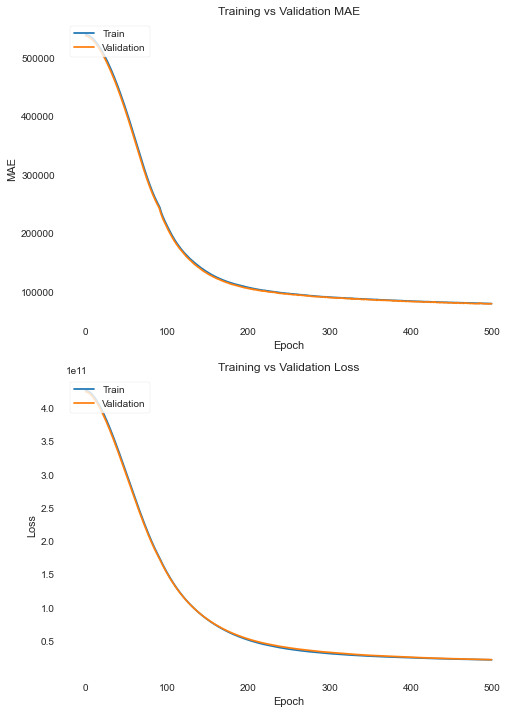

In [247]:
plot_hist(first_history.history, xsize=8, ysize=12)

In [251]:
first_y_train_res = model.predict(X_train)
first_y_test_res = model.predict(X_test)

In [263]:
model1_train_score = r2_score(Y_train,first_y_train_res)
print('training score: ', model1_train_score)

training score:  0.8386194671676772


In [265]:
model1_test_score = r2_score(Y_test,first_y_test_res)
print('test score: ', model1_test_score)

test score:  0.8373960450727119


<h2> Second Model </h2>

In [267]:
model = model_2(X_train.shape[1],1)
model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 100)               1900      
_________________________________________________________________
dropout_1 (Dropout)          (None, 100)               0         
_________________________________________________________________
dense_11 (Dense)             (None, 50)                5050      
_________________________________________________________________
dropout_2 (Dropout)          (None, 50)                0         
_________________________________________________________________
dense_12 (Dense)             (None, 20)                1020      
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 21        
Total params: 7,991
Trainable params: 7,991
Non-trainable params: 0
____________________________________________________

In [268]:
second_history = model.fit(X_train, Y_train,
    batch_size=128,
    epochs=500,
    shuffle=True,
    verbose=2,
    validation_data=(X_test, Y_test)
    )

Train on 15127 samples, validate on 6484 samples
Epoch 1/500
 - 1s - loss: 427022380969.0815 - mean_absolute_error: 540764.5000 - val_loss: 424743896232.6663 - val_mean_absolute_error: 538078.3125
Epoch 2/500
 - 0s - loss: 425681638029.3779 - mean_absolute_error: 539538.5625 - val_loss: 421888650346.7589 - val_mean_absolute_error: 535433.5625
Epoch 3/500
 - 0s - loss: 420580906384.5426 - mean_absolute_error: 534792.1250 - val_loss: 414182206166.4652 - val_mean_absolute_error: 528190.5000
Epoch 4/500
 - 0s - loss: 409722069349.9634 - mean_absolute_error: 524543.0625 - val_loss: 400018782204.2098 - val_mean_absolute_error: 514606.9375
Epoch 5/500
 - 0s - loss: 391885951472.3290 - mean_absolute_error: 507253.9375 - val_loss: 378508505060.2048 - val_mean_absolute_error: 493262.2188
Epoch 6/500
 - 0s - loss: 366866922831.1506 - mean_absolute_error: 481831.5312 - val_loss: 350074496375.8668 - val_mean_absolute_error: 463542.3125
Epoch 7/500
 - 0s - loss: 335434111996.6830 - mean_absolute_err

Epoch 57/500
 - 0s - loss: 38127174608.2761 - mean_absolute_error: 116655.7734 - val_loss: 35436148434.0432 - val_mean_absolute_error: 106449.4219
Epoch 58/500
 - 0s - loss: 38010487309.1664 - mean_absolute_error: 116718.2031 - val_loss: 34916950261.1030 - val_mean_absolute_error: 105919.2969
Epoch 59/500
 - 0s - loss: 37478567250.3323 - mean_absolute_error: 116890.8516 - val_loss: 34583109402.0580 - val_mean_absolute_error: 106340.2734
Epoch 60/500
 - 0s - loss: 37578666410.3338 - mean_absolute_error: 116392.9219 - val_loss: 34237095076.8760 - val_mean_absolute_error: 105844.8984
Epoch 61/500
 - 0s - loss: 37415015484.0442 - mean_absolute_error: 116861.3984 - val_loss: 33943708198.8501 - val_mean_absolute_error: 104922.7266
Epoch 62/500
 - 0s - loss: 37018965736.5611 - mean_absolute_error: 115604.0938 - val_loss: 33729033940.5700 - val_mean_absolute_error: 104532.1641
Epoch 63/500
 - 0s - loss: 36675911418.9738 - mean_absolute_error: 115989.5781 - val_loss: 33414897474.4874 - val_mean

Epoch 113/500
 - 0s - loss: 30477813240.7229 - mean_absolute_error: 106468.0078 - val_loss: 25734874812.5651 - val_mean_absolute_error: 95196.2891
Epoch 114/500
 - 0s - loss: 29824752071.7128 - mean_absolute_error: 106633.9766 - val_loss: 25691265581.1672 - val_mean_absolute_error: 96100.4531
Epoch 115/500
 - 0s - loss: 30056035373.2870 - mean_absolute_error: 106578.3750 - val_loss: 25551376957.5916 - val_mean_absolute_error: 94845.1016
Epoch 116/500
 - 0s - loss: 30080565381.7624 - mean_absolute_error: 106801.7969 - val_loss: 25731553732.3035 - val_mean_absolute_error: 94975.7031
Epoch 117/500
 - 0s - loss: 30593086466.0985 - mean_absolute_error: 107157.1094 - val_loss: 25383386760.7650 - val_mean_absolute_error: 94616.2109
Epoch 118/500
 - 0s - loss: 30304613312.9773 - mean_absolute_error: 107191.9297 - val_loss: 25322769489.4904 - val_mean_absolute_error: 94535.8281
Epoch 119/500
 - 0s - loss: 30133110515.9336 - mean_absolute_error: 106973.9219 - val_loss: 25229181314.6058 - val_mea

Epoch 169/500
 - 0s - loss: 26347263779.5899 - mean_absolute_error: 101300.8438 - val_loss: 22062102665.7125 - val_mean_absolute_error: 89506.8203
Epoch 170/500
 - 0s - loss: 26487415338.4100 - mean_absolute_error: 101306.3359 - val_loss: 22097183658.7193 - val_mean_absolute_error: 89496.7422
Epoch 171/500
 - 0s - loss: 26212651154.5565 - mean_absolute_error: 102284.8047 - val_loss: 21989235744.2172 - val_mean_absolute_error: 89270.1328
Epoch 172/500
 - 0s - loss: 26615955908.0574 - mean_absolute_error: 101487.2969 - val_loss: 21810488227.1388 - val_mean_absolute_error: 89483.6016
Epoch 173/500
 - 0s - loss: 26485640995.4545 - mean_absolute_error: 101617.4375 - val_loss: 21779133925.7841 - val_mean_absolute_error: 90033.8047
Epoch 174/500
 - 0s - loss: 26260770313.0371 - mean_absolute_error: 100786.0625 - val_loss: 21775829535.2696 - val_mean_absolute_error: 89175.9453
Epoch 175/500
 - 0s - loss: 26007521897.2296 - mean_absolute_error: 101300.0234 - val_loss: 21666904148.6490 - val_mea

Epoch 225/500
 - 0s - loss: 24391460362.7294 - mean_absolute_error: 98658.3984 - val_loss: 20035703339.9038 - val_mean_absolute_error: 85687.3906
Epoch 226/500
 - 0s - loss: 25005466306.5850 - mean_absolute_error: 99497.3750 - val_loss: 19922174797.2264 - val_mean_absolute_error: 86863.8594
Epoch 227/500
 - 0s - loss: 23982685855.9937 - mean_absolute_error: 98451.2656 - val_loss: 20008533623.0771 - val_mean_absolute_error: 85894.6719
Epoch 228/500
 - 0s - loss: 24509975734.9756 - mean_absolute_error: 99269.6328 - val_loss: 19803733136.6613 - val_mean_absolute_error: 85930.9922
Epoch 229/500
 - 0s - loss: 24153378015.1856 - mean_absolute_error: 99000.7109 - val_loss: 19845339060.1949 - val_mean_absolute_error: 85608.7734
Epoch 230/500
 - 0s - loss: 24621258383.4764 - mean_absolute_error: 99668.2734 - val_loss: 19853123045.7841 - val_mean_absolute_error: 85916.4844
Epoch 231/500
 - 0s - loss: 25177154102.7302 - mean_absolute_error: 99476.6953 - val_loss: 19757935463.7582 - val_mean_absol

Epoch 282/500
 - 0s - loss: 23262589789.1971 - mean_absolute_error: 97244.3047 - val_loss: 18965546834.9118 - val_mean_absolute_error: 83697.7891
Epoch 283/500
 - 0s - loss: 23142538541.3039 - mean_absolute_error: 96760.5234 - val_loss: 18782365608.8242 - val_mean_absolute_error: 84101.8906
Epoch 284/500
 - 0s - loss: 23378495435.0637 - mean_absolute_error: 97190.6719 - val_loss: 18798137044.5700 - val_mean_absolute_error: 84020.0234
Epoch 285/500
 - 0s - loss: 23118964768.5267 - mean_absolute_error: 97360.8281 - val_loss: 18876237784.8341 - val_mean_absolute_error: 83420.5391
Epoch 286/500
 - 0s - loss: 22829725460.3588 - mean_absolute_error: 97095.5547 - val_loss: 18731376151.0574 - val_mean_absolute_error: 84413.8516
Epoch 287/500
 - 0s - loss: 23452703941.3266 - mean_absolute_error: 97365.5625 - val_loss: 18715913974.6823 - val_mean_absolute_error: 83730.1484
Epoch 288/500
 - 0s - loss: 22888591718.6403 - mean_absolute_error: 97092.7344 - val_loss: 18709226146.6650 - val_mean_absol

Epoch 339/500
 - 0s - loss: 22777563129.2983 - mean_absolute_error: 96509.6562 - val_loss: 18081449128.6663 - val_mean_absolute_error: 82489.2266
Epoch 340/500
 - 0s - loss: 22632850055.6917 - mean_absolute_error: 96182.9688 - val_loss: 18138846337.5003 - val_mean_absolute_error: 82168.0078
Epoch 341/500
 - 0s - loss: 22479627355.1832 - mean_absolute_error: 96733.8203 - val_loss: 18107109862.4158 - val_mean_absolute_error: 82553.6250
Epoch 342/500
 - 0s - loss: 22379851667.5550 - mean_absolute_error: 96033.5859 - val_loss: 18326636785.3128 - val_mean_absolute_error: 82008.8750
Epoch 343/500
 - 0s - loss: 22021971973.6524 - mean_absolute_error: 95688.6953 - val_loss: 18162199130.6502 - val_mean_absolute_error: 82049.2656
Epoch 344/500
 - 0s - loss: 22827521461.0971 - mean_absolute_error: 96934.0547 - val_loss: 18129589097.0216 - val_mean_absolute_error: 82391.2734
Epoch 345/500
 - 0s - loss: 22129311582.3479 - mean_absolute_error: 95885.2812 - val_loss: 18096298374.3961 - val_mean_absol

Epoch 396/500
 - 0s - loss: 21403569221.1151 - mean_absolute_error: 94946.9766 - val_loss: 18031477868.0222 - val_mean_absolute_error: 81564.0938
Epoch 397/500
 - 0s - loss: 21949736466.9203 - mean_absolute_error: 95427.2031 - val_loss: 17859292537.1302 - val_mean_absolute_error: 82448.7422
Epoch 398/500
 - 0s - loss: 21932388005.8153 - mean_absolute_error: 95098.8047 - val_loss: 17862746791.7187 - val_mean_absolute_error: 81213.0391
Epoch 399/500
 - 0s - loss: 21912047078.6488 - mean_absolute_error: 95441.3516 - val_loss: 17741449080.8143 - val_mean_absolute_error: 81935.0000
Epoch 400/500
 - 0s - loss: 21989127925.4229 - mean_absolute_error: 95794.3359 - val_loss: 18010674222.1147 - val_mean_absolute_error: 81146.6172
Epoch 401/500
 - 0s - loss: 21257152652.6672 - mean_absolute_error: 94869.3594 - val_loss: 17688796908.5750 - val_mean_absolute_error: 81483.5000
Epoch 402/500
 - 0s - loss: 21495938131.3984 - mean_absolute_error: 94722.5469 - val_loss: 17670006461.8285 - val_mean_absol

Epoch 453/500
 - 0s - loss: 21423037472.4929 - mean_absolute_error: 94712.7891 - val_loss: 17546229241.9988 - val_mean_absolute_error: 79965.1094
Epoch 454/500
 - 0s - loss: 21339962586.6501 - mean_absolute_error: 94445.6484 - val_loss: 17565138111.4078 - val_mean_absolute_error: 79983.8438
Epoch 455/500
 - 0s - loss: 21479421517.3737 - mean_absolute_error: 94275.9609 - val_loss: 17630430840.3405 - val_mean_absolute_error: 80017.8828
Epoch 456/500
 - 0s - loss: 21137158325.7233 - mean_absolute_error: 94002.4375 - val_loss: 17405062767.4966 - val_mean_absolute_error: 80225.3438
Epoch 457/500
 - 0s - loss: 20821844672.8250 - mean_absolute_error: 93827.8438 - val_loss: 17492190548.4911 - val_mean_absolute_error: 79926.6953
Epoch 458/500
 - 0s - loss: 20727209629.6921 - mean_absolute_error: 93433.3203 - val_loss: 17499796920.3010 - val_mean_absolute_error: 79906.7891
Epoch 459/500
 - 0s - loss: 20950646528.9308 - mean_absolute_error: 93958.8594 - val_loss: 17501815731.5632 - val_mean_absol

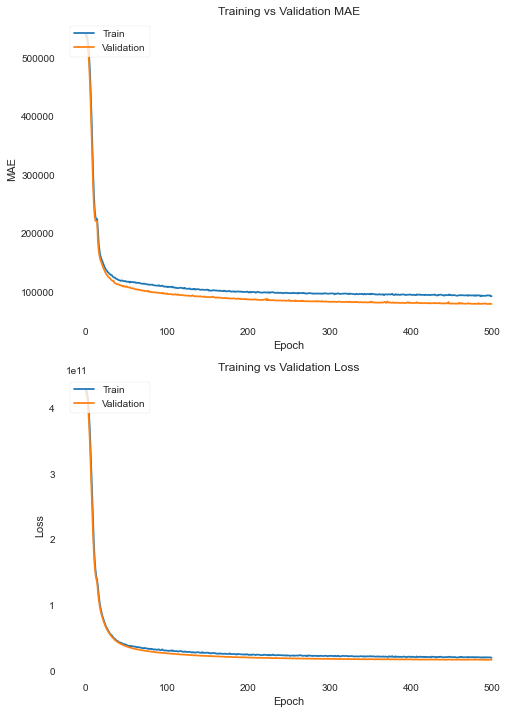

In [269]:
plot_hist(second_history.history, xsize=8, ysize=12)

In [270]:
second_y_train_res = model.predict(X_train)
second_y_test_res = model.predict(X_test)

In [296]:
model2_train_score = r2_score(Y_train,second_y_train_res)
print('training score: ', model2_train_score)

training score:  0.8751384534142231


In [297]:
model2_test_score = r2_score(Y_test,second_y_test_res)
print('test score: ', model2_test_score)

test score:  0.8720715951862192


<h2> Third Model </h2>

In [274]:
model = model_3(X_train.shape[1],1)
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_14 (Dense)             (None, 80)                1520      
_________________________________________________________________
dropout_3 (Dropout)          (None, 80)                0         
_________________________________________________________________
dense_15 (Dense)             (None, 120)               9720      
_________________________________________________________________
dropout_4 (Dropout)          (None, 120)               0         
_________________________________________________________________
dense_16 (Dense)             (None, 20)                2420      
_________________________________________________________________
dropout_5 (Dropout)          (None, 20)                0         
_________________________________________________________________
dense_17 (Dense)             (None, 10)               

In [275]:
third_history = model.fit(X_train, Y_train,
    batch_size=128,
    epochs=500,
    shuffle=True,
    verbose=2,
    validation_data=(X_test, Y_test)
    )

Train on 15127 samples, validate on 6484 samples
Epoch 1/500
 - 1s - loss: 418451342632.2946 - mean_absolute_error: 532714.2500 - val_loss: 380070169438.9142 - val_mean_absolute_error: 495056.5938
Epoch 2/500
 - 0s - loss: 256458776158.4663 - mean_absolute_error: 350307.6875 - val_loss: 143009961176.6761 - val_mean_absolute_error: 219985.2500
Epoch 3/500
 - 0s - loss: 134069308093.9819 - mean_absolute_error: 224908.3906 - val_loss: 112504264240.3257 - val_mean_absolute_error: 184678.1562
Epoch 4/500
 - 0s - loss: 91237813710.1437 - mean_absolute_error: 167675.3750 - val_loss: 72325679635.8988 - val_mean_absolute_error: 143015.6250
Epoch 5/500
 - 0s - loss: 70125010829.4626 - mean_absolute_error: 152652.2031 - val_loss: 60854237842.2406 - val_mean_absolute_error: 138052.2656
Epoch 6/500
 - 0s - loss: 60019774288.3353 - mean_absolute_error: 146406.5781 - val_loss: 53432991923.4053 - val_mean_absolute_error: 129212.8516
Epoch 7/500
 - 0s - loss: 55771077109.0675 - mean_absolute_error: 139

Epoch 57/500
 - 0s - loss: 33323684446.9402 - mean_absolute_error: 116141.1094 - val_loss: 27253721998.9241 - val_mean_absolute_error: 102847.3203
Epoch 58/500
 - 0s - loss: 33731577104.6018 - mean_absolute_error: 116553.2891 - val_loss: 27531023804.0913 - val_mean_absolute_error: 102781.9141
Epoch 59/500
 - 0s - loss: 32925733789.0998 - mean_absolute_error: 116493.7891 - val_loss: 26883863973.3498 - val_mean_absolute_error: 102945.1562
Epoch 60/500
 - 0s - loss: 32954970954.3783 - mean_absolute_error: 116250.1875 - val_loss: 28048954165.2215 - val_mean_absolute_error: 103517.3281
Epoch 61/500
 - 0s - loss: 33846021291.8739 - mean_absolute_error: 116906.4062 - val_loss: 26792939786.5811 - val_mean_absolute_error: 103217.6953
Epoch 62/500
 - 0s - loss: 33318801872.5130 - mean_absolute_error: 117089.6094 - val_loss: 26870193367.4127 - val_mean_absolute_error: 103874.2734
Epoch 63/500
 - 0s - loss: 33189950977.4554 - mean_absolute_error: 116643.3203 - val_loss: 26983822738.3985 - val_mean

Epoch 113/500
 - 0s - loss: 31885647375.4003 - mean_absolute_error: 113610.6250 - val_loss: 24490322206.7958 - val_mean_absolute_error: 97650.4297
Epoch 114/500
 - 0s - loss: 30928333099.4762 - mean_absolute_error: 113259.6172 - val_loss: 25293525149.9272 - val_mean_absolute_error: 97705.4141
Epoch 115/500
 - 0s - loss: 31778301520.6568 - mean_absolute_error: 113066.5781 - val_loss: 24360598359.3337 - val_mean_absolute_error: 97281.5703
Epoch 116/500
 - 0s - loss: 30763179809.9652 - mean_absolute_error: 112271.2891 - val_loss: 24099482476.8118 - val_mean_absolute_error: 97461.2344
Epoch 117/500
 - 0s - loss: 31096603364.9734 - mean_absolute_error: 112495.2031 - val_loss: 24907396174.9636 - val_mean_absolute_error: 98288.2188
Epoch 118/500
 - 0s - loss: 30985718345.3459 - mean_absolute_error: 112609.7422 - val_loss: 24887900427.8445 - val_mean_absolute_error: 97205.6094
Epoch 119/500
 - 0s - loss: 29915330732.0769 - mean_absolute_error: 111254.8672 - val_loss: 24157719886.1740 - val_mea

Epoch 169/500
 - 0s - loss: 27563677497.6580 - mean_absolute_error: 107496.3594 - val_loss: 22466879330.0728 - val_mean_absolute_error: 91449.2500
Epoch 170/500
 - 0s - loss: 28968107756.0812 - mean_absolute_error: 108818.8594 - val_loss: 22456588869.1721 - val_mean_absolute_error: 91659.6797
Epoch 171/500
 - 0s - loss: 28348360918.8593 - mean_absolute_error: 108800.6719 - val_loss: 22288310595.4349 - val_mean_absolute_error: 91592.6562
Epoch 172/500
 - 0s - loss: 28451673941.0061 - mean_absolute_error: 108561.2969 - val_loss: 22009352219.7952 - val_mean_absolute_error: 91803.1953
Epoch 173/500
 - 0s - loss: 28481442016.7425 - mean_absolute_error: 108607.7188 - val_loss: 22285529386.1666 - val_mean_absolute_error: 92239.7891
Epoch 174/500
 - 0s - loss: 28255330880.2073 - mean_absolute_error: 108495.5312 - val_loss: 21866385174.2677 - val_mean_absolute_error: 91049.9297
Epoch 175/500
 - 0s - loss: 28969958522.0514 - mean_absolute_error: 108531.9375 - val_loss: 22016382498.4281 - val_mea

Epoch 225/500
 - 0s - loss: 27714233461.1775 - mean_absolute_error: 106520.1328 - val_loss: 21037237530.3738 - val_mean_absolute_error: 88437.0156
Epoch 226/500
 - 0s - loss: 26928733914.2101 - mean_absolute_error: 104720.3281 - val_loss: 21526971211.9630 - val_mean_absolute_error: 88348.4766
Epoch 227/500
 - 0s - loss: 26812738214.6953 - mean_absolute_error: 105052.7422 - val_loss: 21082019550.6774 - val_mean_absolute_error: 88073.6641
Epoch 228/500
 - 0s - loss: 26983854424.6954 - mean_absolute_error: 105302.1641 - val_loss: 20820365718.8205 - val_mean_absolute_error: 88326.5859
Epoch 229/500
 - 0s - loss: 26690785523.6967 - mean_absolute_error: 104874.5469 - val_loss: 21082225379.0993 - val_mean_absolute_error: 87934.2656
Epoch 230/500
 - 0s - loss: 27065488872.0703 - mean_absolute_error: 105895.2266 - val_loss: 21247295288.3800 - val_mean_absolute_error: 87856.9844
Epoch 231/500
 - 0s - loss: 26926006103.4431 - mean_absolute_error: 105354.3125 - val_loss: 21100328023.8075 - val_mea

Epoch 281/500
 - 0s - loss: 25655902382.7508 - mean_absolute_error: 102533.9375 - val_loss: 20787668688.7798 - val_mean_absolute_error: 86748.9609
Epoch 282/500
 - 0s - loss: 25446280651.9775 - mean_absolute_error: 102655.8281 - val_loss: 20604443048.5083 - val_mean_absolute_error: 86614.1328
Epoch 283/500
 - 0s - loss: 26056407028.2213 - mean_absolute_error: 102990.0000 - val_loss: 21130549030.6922 - val_mean_absolute_error: 85998.9062
Epoch 284/500
 - 0s - loss: 26566831031.5002 - mean_absolute_error: 103741.0000 - val_loss: 21215133982.7958 - val_mean_absolute_error: 86409.1094
Epoch 285/500
 - 0s - loss: 25719164998.4690 - mean_absolute_error: 102503.0469 - val_loss: 20737156965.8630 - val_mean_absolute_error: 85757.9297
Epoch 286/500
 - 0s - loss: 25732893685.4398 - mean_absolute_error: 102838.5000 - val_loss: 20465645360.7995 - val_mean_absolute_error: 85734.5703
Epoch 287/500
 - 0s - loss: 26006324265.9700 - mean_absolute_error: 103172.2734 - val_loss: 21279349416.9821 - val_mea

Epoch 337/500
 - 0s - loss: 24564530786.2572 - mean_absolute_error: 100773.0078 - val_loss: 20014909023.0722 - val_mean_absolute_error: 84594.4062
Epoch 338/500
 - 0s - loss: 25591076725.0929 - mean_absolute_error: 101782.3281 - val_loss: 20832792788.2542 - val_mean_absolute_error: 86512.5703
Epoch 339/500
 - 0s - loss: 25463431748.2689 - mean_absolute_error: 101936.8828 - val_loss: 20301738429.9864 - val_mean_absolute_error: 84704.3281
Epoch 340/500
 - 0s - loss: 25700042871.9529 - mean_absolute_error: 102152.1562 - val_loss: 20272415219.0500 - val_mean_absolute_error: 84612.3359
Epoch 341/500
 - 0s - loss: 24669817566.2040 - mean_absolute_error: 100710.4219 - val_loss: 20207199403.1931 - val_mean_absolute_error: 84594.5859
Epoch 342/500
 - 0s - loss: 24843269502.7392 - mean_absolute_error: 101397.7734 - val_loss: 20110446631.1659 - val_mean_absolute_error: 84642.0156
Epoch 343/500
 - 0s - loss: 24894071372.6629 - mean_absolute_error: 101478.6172 - val_loss: 20452353536.3159 - val_mea

Epoch 393/500
 - 0s - loss: 23600960255.0354 - mean_absolute_error: 98938.5234 - val_loss: 19864259290.2554 - val_mean_absolute_error: 83114.6875
Epoch 394/500
 - 0s - loss: 24724431800.3802 - mean_absolute_error: 100797.6094 - val_loss: 19830799001.8211 - val_mean_absolute_error: 83751.8984
Epoch 395/500
 - 0s - loss: 25225776382.0538 - mean_absolute_error: 100843.9688 - val_loss: 20731353584.5231 - val_mean_absolute_error: 83682.5781
Epoch 396/500
 - 0s - loss: 24690483984.7034 - mean_absolute_error: 100531.5703 - val_loss: 19699813854.2036 - val_mean_absolute_error: 83500.7500
Epoch 397/500
 - 0s - loss: 25061325424.2020 - mean_absolute_error: 100549.1797 - val_loss: 19942370183.3436 - val_mean_absolute_error: 84025.9688
Epoch 398/500
 - 0s - loss: 24743729362.1884 - mean_absolute_error: 100201.3359 - val_loss: 19596411876.8365 - val_mean_absolute_error: 84257.4219
Epoch 399/500
 - 0s - loss: 23876276690.0699 - mean_absolute_error: 100174.1094 - val_loss: 19803788605.7495 - val_mean

Epoch 449/500
 - 0s - loss: 24505982266.1657 - mean_absolute_error: 100550.6875 - val_loss: 19251684785.9840 - val_mean_absolute_error: 82766.3906
Epoch 450/500
 - 0s - loss: 22944307880.0492 - mean_absolute_error: 98696.1328 - val_loss: 19241974726.5145 - val_mean_absolute_error: 82033.5078
Epoch 451/500
 - 0s - loss: 23099460492.3118 - mean_absolute_error: 98509.7344 - val_loss: 19443815336.1925 - val_mean_absolute_error: 82499.3281
Epoch 452/500
 - 0s - loss: 23923647642.4766 - mean_absolute_error: 99484.9062 - val_loss: 19176400498.0234 - val_mean_absolute_error: 82006.2344
Epoch 453/500
 - 0s - loss: 23255884179.5888 - mean_absolute_error: 98123.6875 - val_loss: 19336140773.4682 - val_mean_absolute_error: 82019.8359
Epoch 454/500
 - 0s - loss: 23448745699.8226 - mean_absolute_error: 98322.2266 - val_loss: 19701395310.7070 - val_mean_absolute_error: 82200.3906
Epoch 455/500
 - 0s - loss: 23585182824.1126 - mean_absolute_error: 98614.0547 - val_loss: 20319362024.6268 - val_mean_abso

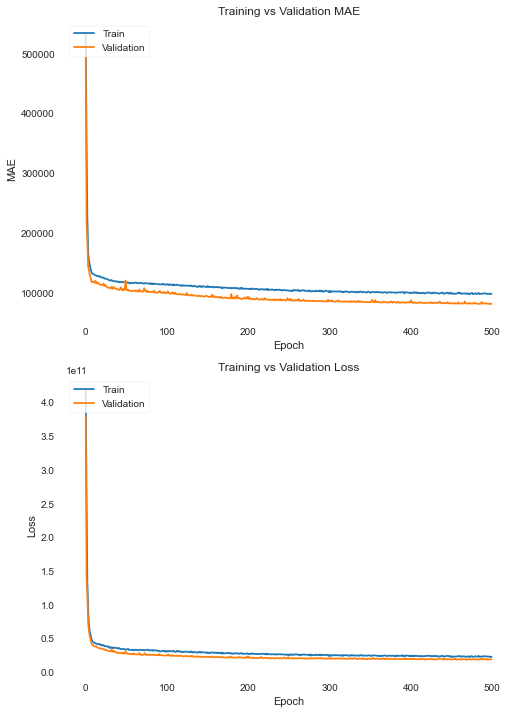

In [276]:
plot_hist(third_history.history, xsize=8, ysize=12)

In [277]:
third_y_train_res = model.predict(X_train)
third_y_test_res = model.predict(X_test)

In [299]:
model3_train_score = r2_score(Y_train,third_y_train_res)
print('training score: ', model3_train_score)

training score:  0.8711146670638749


In [298]:
model3_test_score = r2_score(Y_test,third_y_test_res)
print('test score: ', model3_test_score)

test score:  0.8561035313583827


<h1>R Squared Score summary </h1>

In [300]:
neural_networks_res = pd.DataFrame({
    'Method':['NN First Model', 'NN Second Model', 'NN Third Model'],
    'Train Results' : [model1_train_score,model2_train_score,model3_train_score],
    'Test Results' : [model1_test_score,model2_test_score,model3_test_score]
})

In [301]:
res = results.append(neural_networks_res, ignore_index = True)


In [302]:
res

,Method,Train Results,Test Results
0,Linear Regression,0.699205,0.702297
1,Elastic-Net,0.617939,0.629052
2,Lasso,0.687184,0.692273
3,Bayessian Ridge,0.699075,0.702992
4,SGDRegressor,0.697705,0.702273
5,AdaBoostRegressor,0.575961,0.579728
6,NN First Model,0.838619,0.837396
7,NN Second Model,0.875138,0.872072
8,NN Third Model,0.871115,0.856104
